<a href="https://colab.research.google.com/github/lilchengzi/BA820-project/blob/main/Final_BA820_InstaCart_Prediction_Team_A08.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# FutureFridge with Instacart: Precision Grocery Predictions

---









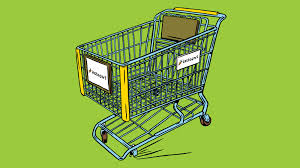

## 1. Importing libraries and loading the dataset

In [1]:
!pip install opendatasets

>[Instacart Shopping App](#scrollTo=zj1BgXRfRNyp)

>>[Importing libraries and loading the dataset](#scrollTo=1QLA-2VL9xak)

>>[Exploring the dataset](#scrollTo=lla91x9g93lv)

>>[Exploratory Data Analysis](#scrollTo=csRGoKd-_oAa)

>>[Market Basket Analysis](#scrollTo=feKfr1AM8McP)

>>>[4.1 Data Preparation](#scrollTo=4KrUPbEujRQg)

>>>[4.2 Apriori Algorithm](#scrollTo=zCw2l4f8BuZc)

>>>[4.3 Association Rules](#scrollTo=8LO5yWeGW5A7)



Necessary Libraries

In [2]:
#importing necessary libraries

import opendatasets as od
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
od.download(
    "https://www.kaggle.com/datasets/yasserh/instacart-online-grocery-basket-analysis-dataset")

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: aishwaryarauthan
Your Kaggle Key: ··········


100%|██████████| 197M/197M [00:05<00:00, 38.7MB/s]


In [4]:
# loading all dataframes

aisles = pd.read_csv('/content/instacart-online-grocery-basket-analysis-dataset/aisles.csv')
dept = pd.read_csv('/content/instacart-online-grocery-basket-analysis-dataset/departments.csv')
orders_prior = pd.read_csv('/content/instacart-online-grocery-basket-analysis-dataset/order_products__prior.csv')
orders = pd.read_csv('/content/instacart-online-grocery-basket-analysis-dataset/orders.csv')
prod = pd.read_csv('/content/instacart-online-grocery-basket-analysis-dataset/products.csv')

In [ ]:
orders_prior.shape

(32434489, 4)

Since this dataframe is too huge to work with, we will sample it to a smaller size moving forward. Given the large size of the dataframe (32,434,489 rows), it's practical to sample it to a smaller size for efficient analysis. This approach ensures manageable data exploration and facilitates meaningful inferences without overwhelming computational resources.

In [5]:
orders_prior1 = orders_prior.sample(frac=0.01, random_state=42)
orders_prior1

,order_id,product_id,add_to_cart_order,reordered
29481110,3109255,34099,16,0
2852353,301098,41950,5,0
11194500,1181866,45066,8,0
15909397,1678630,8859,2,1
6101870,644090,24781,2,0
...,...,...,...,...
13579781,1433375,34969,5,1
22168330,2338221,10248,10,0
4041427,426460,27676,7,0
4328233,456879,38028,2,1


In [6]:
# joining them together on common keys

df1 = pd.merge(prod, aisles, how='inner', on='aisle_id')
df2 = df1.merge(dept, how='inner', on='department_id')
df3 = df2.merge(orders_prior1, how='inner', on='product_id')
df4 = df3.merge(orders, how='inner', on='order_id')

df4
df = df4.copy()
df

,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,924888,11,1,177411,prior,72,5,1,4.0
1,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,268506,13,1,157915,prior,20,1,9,20.0
2,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,2109664,4,0,145504,prior,3,2,14,1.0
3,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,3209740,2,1,7981,prior,24,2,13,6.0
4,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,1550174,1,1,66968,prior,15,3,16,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324340,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,1954609,7,0,130601,prior,14,5,13,9.0
324341,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,2323735,1,1,90235,prior,30,3,10,1.0
324342,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,878186,7,1,130467,prior,2,4,17,5.0
324343,48778,"Fit Super A Juice, Cold Pressed, Carrot/Apple/...",18,10,bulk dried fruits vegetables,bulk,2748395,1,0,96923,prior,4,4,10,2.0


## 2. Data Cleaning

In [ ]:
df.eval_set.unique()

array(['prior'], dtype=object)

In [7]:
df = df.drop('eval_set', axis=1)

Dropping the eval_set column since it holds no relevance and is merely a label for orders with only one label present.

In [ ]:
df.isna().sum()

product_id                    0
product_name                  0
aisle_id                      0
department_id                 0
aisle                         0
department                    0
order_id                      0
add_to_cart_order             0
reordered                     0
user_id                       0
order_number                  0
order_dow                     0
order_hour_of_day             0
days_since_prior_order    20775
dtype: int64

Null values are only observed in the 'days_since_prior_order' column. We shall explore this further now.

In [ ]:
df[df.days_since_prior_order.isnull()]

,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
15,78,Nutter Butter Cookie Bites Go-Pak,61,19,cookies cakes,snacks,2749907,21,0,63660,1,6,17,NaN
26,449,Chips Ahoy! Chewy Cookies,61,19,cookies cakes,snacks,2283973,22,0,152748,1,0,12,NaN
43,796,Chocolate Reese's Peanut Butter Cup Creme Oreo,61,19,cookies cakes,snacks,542105,2,0,112211,1,1,17,NaN
49,1648,Chocolate Chip 1.4 oz Packs Cookies,61,19,cookies cakes,snacks,2887816,23,0,168253,1,0,16,NaN
50,26283,White Corn,83,4,fresh vegetables,produce,2887816,27,0,168253,1,0,16,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324252,5161,Dried Mango,18,10,bulk dried fruits vegetables,bulk,1965398,2,0,50495,1,1,8,NaN
324253,5161,Dried Mango,18,10,bulk dried fruits vegetables,bulk,411935,1,0,61591,1,4,15,NaN
324268,5161,Dried Mango,18,10,bulk dried fruits vegetables,bulk,1924992,4,0,101510,1,6,8,NaN
324298,5161,Dried Mango,18,10,bulk dried fruits vegetables,bulk,2342697,15,0,171175,1,6,13,NaN


These null values might be suggesting that no prior purchase of the product was made by the customer. We can impute it with an arbitrary float value instead so that it is in line with the datatype of the column and holds value.

In [8]:
# imputing a zero to null values of days_since_prior_order so that those rows can be used for meaningful analysis

df['days_since_prior_order'].fillna(0.0, inplace=True)
df['days_since_prior_order'].isna().sum()

0

Now, we can observe that there is no null values.

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 324345 entries, 0 to 324344
Data columns (total 14 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   product_id              324345 non-null  int64  
 1   product_name            324345 non-null  object 
 2   aisle_id                324345 non-null  int64  
 3   department_id           324345 non-null  int64  
 4   aisle                   324345 non-null  object 
 5   department              324345 non-null  object 
 6   order_id                324345 non-null  int64  
 7   add_to_cart_order       324345 non-null  int64  
 8   reordered               324345 non-null  int64  
 9   user_id                 324345 non-null  int64  
 10  order_number            324345 non-null  int64  
 11  order_dow               324345 non-null  int64  
 12  order_hour_of_day       324345 non-null  int64  
 13  days_since_prior_order  324345 non-null  float64
dtypes: float64(1), int64

The data types seem relevant to their respective columns.

In [ ]:
df.describe()

,product_id,aisle_id,department_id,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
count,324345.000000,324345.000000,324345.000000,3.243450e+05,324345.000000,324345.000000,324345.000000,324345.000000,324345.000000,324345.000000,324345.000000
mean,25551.139194,71.198033,9.938035,1.710520e+06,8.376010,0.589536,102951.981295,17.144796,2.733216,13.428571,10.383033
std,14110.454313,38.222234,6.276621,9.869484e+05,7.158359,0.491919,59441.408028,17.502843,2.090947,4.251041,8.907785
min,1.000000,1.000000,1.000000,4.300000e+01,1.000000,0.000000,2.000000,1.000000,0.000000,0.000000,0.000000
25%,13431.000000,31.000000,4.000000,8.559500e+05,3.000000,0.000000,51566.000000,5.000000,1.000000,10.000000,4.000000
50%,25167.000000,83.000000,9.000000,1.709853e+06,6.000000,1.000000,102527.000000,11.000000,3.000000,13.000000,7.000000
75%,37892.000000,107.000000,16.000000,2.561704e+06,11.000000,1.000000,154508.000000,24.000000,5.000000,16.000000,14.000000
max,49688.000000,134.000000,21.000000,3.421081e+06,110.000000,1.000000,206208.000000,99.000000,6.000000,23.000000,30.000000


In [ ]:
df.describe(include='object')

,product_name,aisle,department
count,324345,324345,324345
unique,25415,134,21
top,Banana,fresh fruits,produce
freq,4754,36393,94761


Having a look at the summary statistics gives us a clearer picture of the dataset to perform further analysis.
"Banana" is the most frequent product, predominantly found in the "fresh fruits" aisle within the "produce" department. This suggests a strong demand for fresh fruits, particularly bananas, which are likely a staple item for consumers. Such insights can guide stocking strategies and promotional efforts to capitalize on popular products and categories.

In [ ]:
# converting day of the week (dow) of order from numerical to weekday name

# Define a mapping dictionary
dow_mapping = {
    0: 'Sunday',
    1: 'Monday',
    2: 'Tuesday',
    3: 'Wednesday',
    4: 'Thursday',
    5: 'Friday',
    6: 'Saturday'
}

# Use the map function to apply the mapping
df['order_dow'] = df['order_dow'].map(dow_mapping)
df

,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,924888,11,1,177411,72,Friday,1,4.0
1,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,268506,13,1,157915,20,Monday,9,20.0
2,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,2109664,4,0,145504,3,Tuesday,14,1.0
3,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,3209740,2,1,7981,24,Tuesday,13,6.0
4,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,1550174,1,1,66968,15,Wednesday,16,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324340,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,1954609,7,0,130601,14,Friday,13,9.0
324341,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,2323735,1,1,90235,30,Wednesday,10,1.0
324342,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,878186,7,1,130467,2,Thursday,17,5.0
324343,48778,"Fit Super A Juice, Cold Pressed, Carrot/Apple/...",18,10,bulk dried fruits vegetables,bulk,2748395,1,0,96923,4,Thursday,10,2.0


The dataset provides information on product sales, highlighting consumer preferences, shopping patterns, and product popularity. By analyzing reorder rates, shopping frequency, and trends in purchase times, we can infer consumer behavior and make informed decisions regarding product placement and inventory management.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 324345 entries, 0 to 324344
Data columns (total 14 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   product_id              324345 non-null  int64  
 1   product_name            324345 non-null  object 
 2   aisle_id                324345 non-null  int64  
 3   department_id           324345 non-null  int64  
 4   aisle                   324345 non-null  object 
 5   department              324345 non-null  object 
 6   order_id                324345 non-null  int64  
 7   add_to_cart_order       324345 non-null  int64  
 8   reordered               324345 non-null  int64  
 9   user_id                 324345 non-null  int64  
 10  order_number            324345 non-null  int64  
 11  order_dow               324345 non-null  object 
 12  order_hour_of_day       324345 non-null  int64  
 13  days_since_prior_order  324345 non-null  float64
dtypes: float64(1), int64

## 3. Exploratory Data Analysis

Performing various exploratory data analyses to get to know the data better.

In [ ]:
# number of unique products in each aisle

df.groupby('aisle').product_id.nunique()

aisle
air fresheners candles           113
asian foods                      320
baby accessories                  12
baby bath body care               50
baby food formula                441
                                ... 
trash bags liners                 65
vitamins supplements             244
water seltzer sparkling water    239
white wines                       63
yogurt                           741
Name: product_id, Length: 134, dtype: int64

In [ ]:
# number of unique products in each departments

df.groupby('department').product_id.nunique()

department
alcohol             398
babies              586
bakery              973
beverages          2425
breakfast           682
bulk                 28
canned goods       1158
dairy eggs         2377
deli                809
dry goods pasta    1030
frozen             2413
household          1398
international       538
meat seafood        539
missing             252
other               166
pantry             2570
personal care      1984
pets                406
produce            1227
snacks             3456
Name: product_id, dtype: int64

In [ ]:
# order id with the biggest order

max_order = df.add_to_cart_order.max()
df[df.add_to_cart_order==max_order].loc[:,['order_id', 'user_id']]

,order_id,user_id
29349,3308010,129928


In [ ]:
# top customers based on purchase quantity

top_cust = df.groupby('user_id').order_id.count().reset_index()
top_cust.sort_values('order_id', ascending = False).head(10)

,user_id,order_id
115796,201268,44
79220,137629,43
80839,140440,37
62530,108187,37
104955,182401,36
41684,72136,35
19369,33731,33
101577,176478,32
94457,164055,32
58010,100330,31


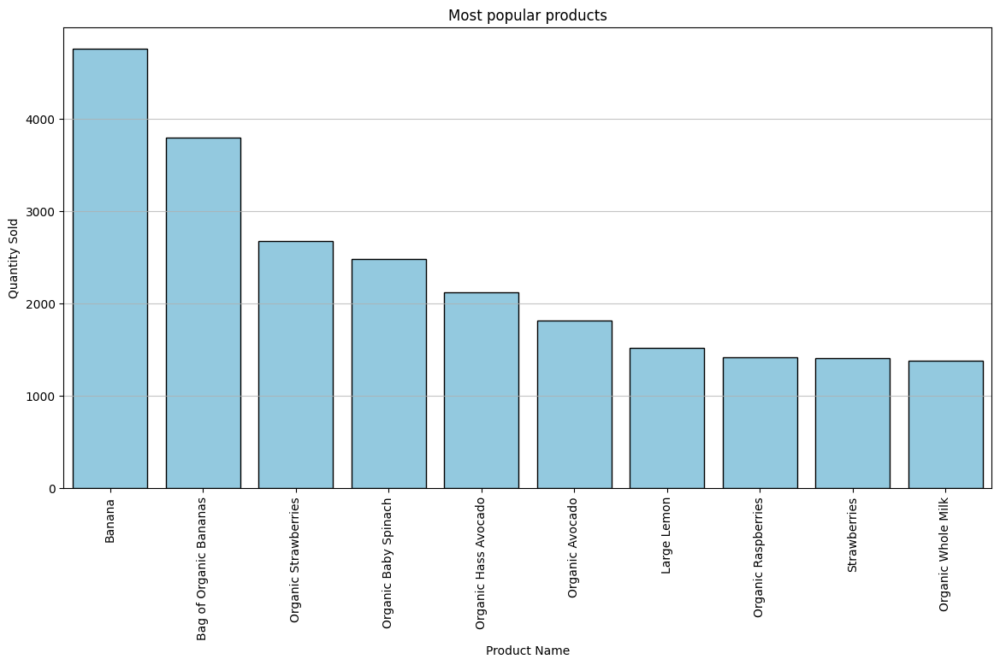

In [ ]:
# most popular products based on purchases

top_prod = df.product_name.value_counts().reset_index()
top_prod = top_prod.sort_values('product_name', ascending = False).head(10)

plt.figure(figsize=(14, 7))
sns.barplot(data=top_prod, x='index', y='product_name', color='skyblue', edgecolor='black')
plt.xlabel('Product Name')
plt.ylabel('Quantity Sold')
plt.title('Most popular products')
plt.xticks(rotation=90)
plt.grid(axis='y', alpha=0.75)
plt.show()

From the visual representation, we can infer the following:

* Bananas are the most popular product by a significant margin, followed by a bag of organic bananas.
* Organic strawberries, organic baby spinach, and organic Hass avocado are moderately popular and have relatively similar quantities sold.
* The remaining products, including organic lemon, large lemon, organic raspberries, strawberries, and organic whole milk, have lower sales compared to the top products but are still among the top 10.
* There is a gradual decrease in the quantity sold from bananas to organic whole milk, indicating that the popularity of products decreases from left to right on the chart.


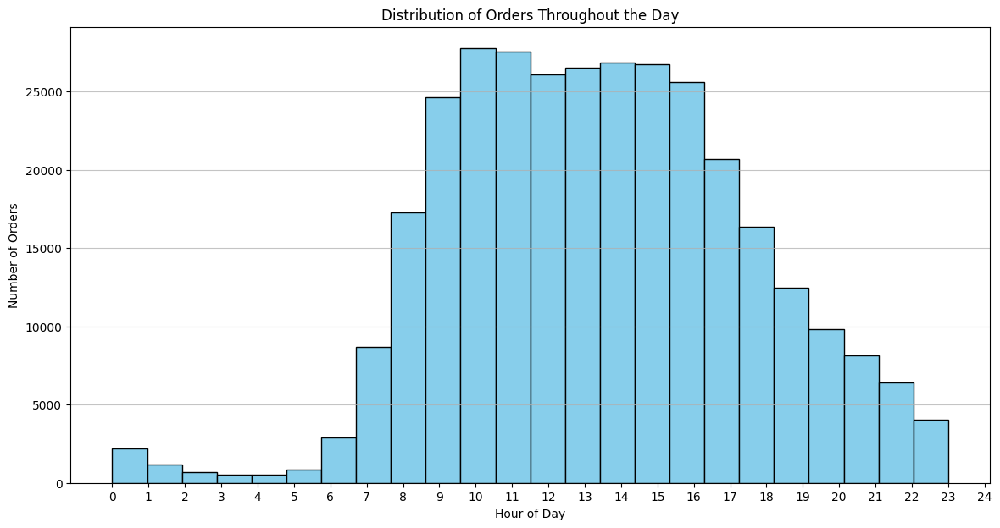

In [ ]:
# Plotting the histogram of the order_hour_of_day
plt.figure(figsize=(14, 7))
plt.hist(df['order_hour_of_day'], bins=24, color='skyblue', edgecolor='black')
plt.title('Distribution of Orders Throughout the Day')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Orders')
plt.xticks(range(0, 25))
plt.grid(axis='y', alpha=0.75)
plt.show()

From the above graph we can  infer the following about the distribution of orders:

* Lowest Activity in Early Hours: There is very low order activity in the early hours of the day, from midnight (0) to 6 AM, which is typical as these are non-peak hours for shopping activities.
* Gradual Increase in Morning: Starting from 6 AM, there is a gradual increase in the number of orders, which suggests that people begin placing orders as the day starts, with a more noticeable rise around 7 AM to 8 AM, possibly as more people wake up and start their day.

* Peak Hours: The peak hours for orders are from 9 AM to 5 PM, with the highest number of orders occurring around 10 AM to 3 PM. This indicates that the majority of orders are placed during the late morning to mid-afternoon hours, which might correspond with common meal preparation times or typical breaks in a workday.

* Evening Decrease: After 5 PM, there is a gradual decline in the number of orders, although there is still a relatively high level of activity until about 7 PM. This could reflect that people are less likely to place orders as they are returning from work or engaging in evening activities.

* Significant Drop at Night: Post 7 PM, there is a more pronounced drop, with a steep decrease after 8 PM. This suggests that by late evening, the frequency of orders diminishes significantly as it approaches midnight.

* Midnight Activity: There is a slight increase in orders just before midnight, which could be attributed to last-minute orders placed before the day ends or promotional activities that end at midnight.

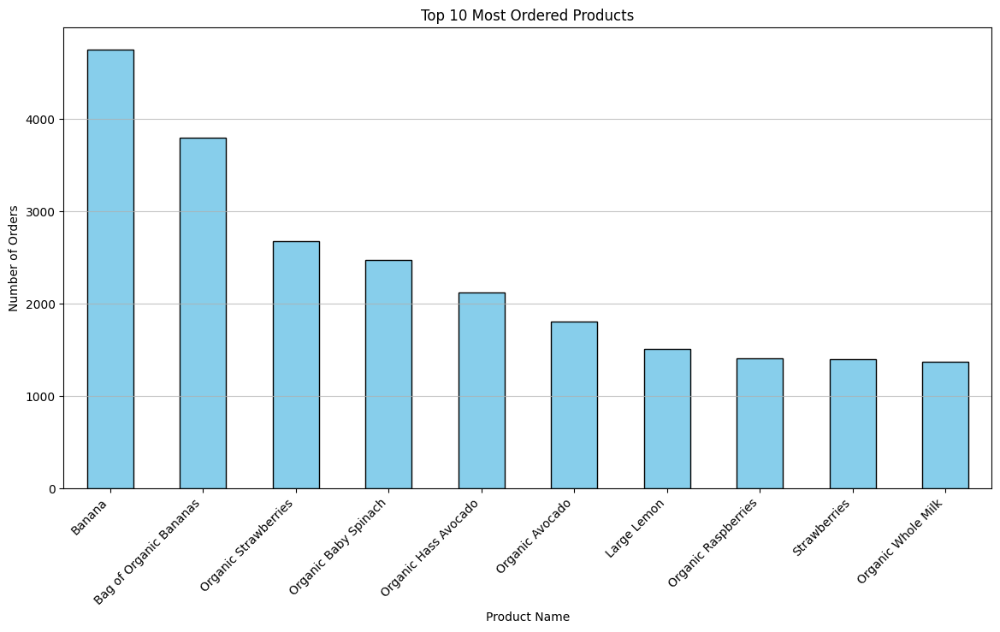

In [ ]:
# Calculate the count of orders per product
top_products = df['product_name'].value_counts().head(10)

plt.figure(figsize=(14, 7))
top_products.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('Top 10 Most Ordered Products')
plt.xlabel('Product Name')
plt.ylabel('Number of Orders')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', alpha=0.75)

plt.show()

The inferences that can be made about consumer purchasing behavior:

* Popularity of Produce: The chart shows a strong preference for fresh produce among the top ordered products. Bananas and organic bananas are the most ordered items, which suggests that these fruits are staples in many households.

* Organic Preference: There is a notable trend towards organic products. Aside from bananas, other organic items like organic strawberries, organic baby spinach, organic Hass avocado, and organic whole milk are among the most ordered. This indicates a consumer preference for organic options, which may be due to health, taste, or environmental concerns.

* Variety in Fruits: A variety of fruits are represented in the top orders, including bananas, strawberries, and avocados. This variety indicates that customers are purchasing a diverse selection of fruits, which might be used for different purposes such as snacking, cooking, or as ingredients in recipes.

* Health-Conscious Choices: The presence of baby spinach and organic items suggests that health-conscious choices are prominent among the top orders. Customers seem to be prioritizing items that are associated with a healthy lifestyle.

* Consistency in Ordering: The fact that these items are the most ordered products could also imply that they are consistently purchased on a regular basis, rather than being one-time purchases. This might be due to their role as essential items in many households.

<ipython-input-25-b70c4caa61a6>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='reordered', data=df, ax=axes[0, 1], palette='coolwarm')
<ipython-input-25-b70c4caa61a6>:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  axes[0, 1].set_xticklabels(['No', 'Yes'])
<ipython-input-25-b70c4caa61a6>:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=top_departments.index, x=top_departments.values, ax=axes[1, 0], palette='cool')


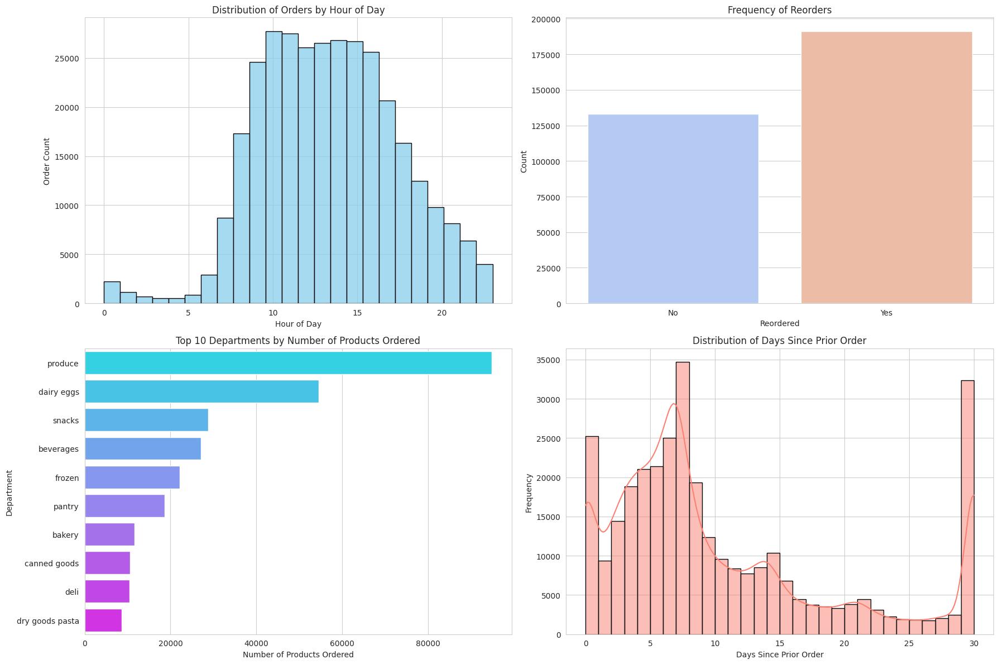

In [ ]:
sns.set_style("whitegrid")
fig, axes = plt.subplots(2, 2, figsize=(18, 12))

# Plot 1: Distribution of Orders by Hour of Day
sns.histplot(df['order_hour_of_day'], bins=24, kde=False, ax=axes[0, 0], color='skyblue', edgecolor='black')
axes[0, 0].set_title('Distribution of Orders by Hour of Day')
axes[0, 0].set_xlabel('Hour of Day')
axes[0, 0].set_ylabel('Order Count')

# Plot 2: Frequency of Reorders
sns.countplot(x='reordered', data=df, ax=axes[0, 1], palette='coolwarm')
axes[0, 1].set_title('Frequency of Reorders')
axes[0, 1].set_xlabel('Reordered')
axes[0, 1].set_ylabel('Count')
axes[0, 1].set_xticklabels(['No', 'Yes'])

# Plot 3: Number of Products Ordered from Each Department (Top 10)
top_departments = df['department'].value_counts().head(10)
sns.barplot(y=top_departments.index, x=top_departments.values, ax=axes[1, 0], palette='cool')
axes[1, 0].set_title('Top 10 Departments by Number of Products Ordered')
axes[1, 0].set_xlabel('Number of Products Ordered')
axes[1, 0].set_ylabel('Department')

# Plot 4: Days Since Prior Order Distribution
sns.histplot(df['days_since_prior_order'], bins=30, kde=True, ax=axes[1, 1], color='salmon', edgecolor='black')
axes[1, 1].set_title('Distribution of Days Since Prior Order')
axes[1, 1].set_xlabel('Days Since Prior Order')
axes[1, 1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

According to the plots the following are the inferences:

Plot 1
* Distribution of Orders by Hour of Day: Orders tend to increase starting early in the morning, peak during the midday hours (likely around lunch time), and then decrease towards the evening. The distribution suggests that the platform could be most actively used for ordering groceries or meals around lunchtime, which may be useful for planning delivery schedules and staffing.

Plot 2
* Frequency of Reorders: The countplot shows that there are more instances of items being reordered than not. For the business, this could mean an opportunity to focus on retention strategies and to ensure that stock levels for frequently reordered items are sufficient.

Plot 3
* Top 10 Departments by Number of Products Ordered: The 'produce' department has the highest number of products ordered, indicating a strong customer preference for fresh fruits and vegetables. The 'dairy eggs' and 'snacks' departments also have a high number of orders, suggesting these are staple items. Understanding the popularity could assist in prioritization of the inventory.

Plot 4
* Distribution of Days Since Prior Order: The distribution here shows that there are common spikes in order placement at specific intervals, the same day or a first timer (indicated by 0), weekly (around 7 days), biweekly (around 14 days), and monthly (around 30 days). This pattern suggests that customers may have a routine or schedule for placing orders. It allows us to set up subscription models to target these regular ordering intervals.

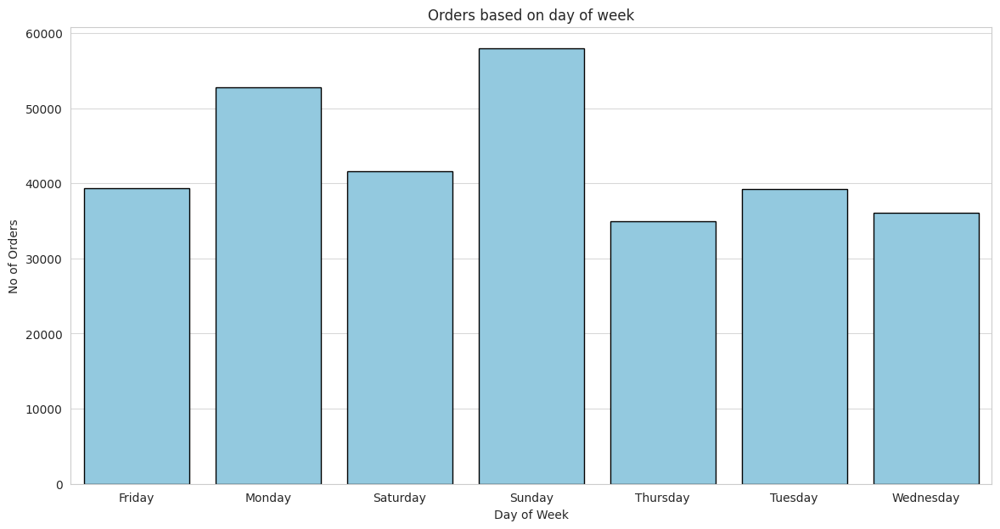

In [ ]:
# what day do most orders take place

dow = df.groupby('order_dow').order_id.nunique().reset_index()

plt.figure(figsize=(14, 7))
sns.barplot(data=dow, x='order_dow', y='order_id', color='skyblue', edgecolor='black')
plt.title('Orders based on day of week')
plt.xlabel('Day of Week')
plt.ylabel('No of Orders')
plt.grid(axis='y', alpha=0.75)
plt.show()

Day of the Week Ordering Trend: From the graph, it is evident that the highest number of orders are placed on Sunday, followed by Monday. The other days of the week exhibit a relatively lower and more uniform number of orders.

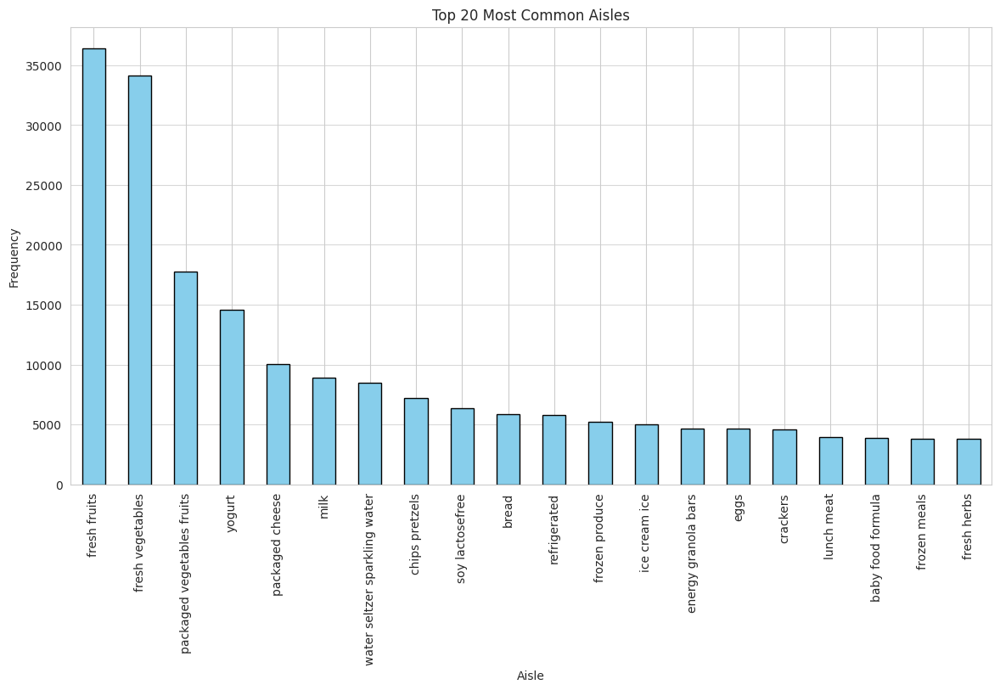

In [ ]:
# Top 20 most common aisles
top_aisles = df4['aisle'].value_counts().head(20)
plt.figure(figsize=(14, 7))

top_aisles.plot(kind='bar',color='skyblue', edgecolor='black')
plt.title('Top 20 Most Common Aisles')
plt.xlabel('Aisle')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.grid(axis='y', alpha=0.75)
plt.show()

Inferences and observations that can be drawn from the graph:
* Popularity of Aisles: The 'Fresh fruits' and 'Fresh vegetables' aisles are the most frequented, with 'Fresh fruits' being the highest. This suggests that fresh produce is very popular among the customers of this store, which could imply a focus on healthy eating or that the store possibly has a reputation for quality produce.
* Lower Frequency Aisles: Towards the end of the list, the aisles like 'Eggs', 'Crackers', 'Lunch meat', 'Baby food formula', and 'Frozen meals' have lower frequencies compared to the top aisles but are still among the top 20, indicating they are relatively popular choices.

* Least Common of the Top Aisles: The 'Frozen fresh herbs' aisle has the lowest frequency among the top 20, which may suggest a lower demand for these items or that they are niche products.

* Implications for Store Layout and Stock: The data could be used to inform store layout decisions, with the most frequented aisles positioned to enhance customer flow and experience. Additionally, it can guide inventory management, ensuring that high-demand items are well-stocked.

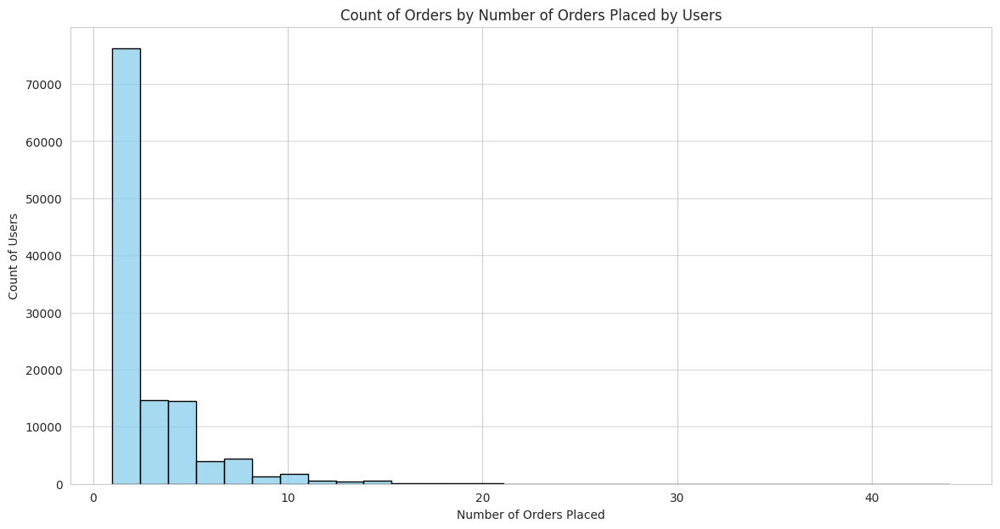

In [ ]:
#Count of orders by the number of orders placed by users
order_counts = df['user_id'].value_counts()
plt.figure(figsize=(14, 7))
sns.histplot(order_counts, bins=30, kde=False, color='skyblue', edgecolor='black')
plt.title('Count of Orders by Number of Orders Placed by Users')
plt.xlabel('Number of Orders Placed')
plt.ylabel('Count of Users')
plt.grid(axis='y', alpha=0.75)
plt.show()

Inference from the above graph:
* High Number of Infrequent Shoppers: There is a significantly high number of users who have placed a very small number of orders. The highest bar is for the 0-1 range on the x-axis, which indicates that the majority of users have placed between 0 and just over 1 order. This could suggest that many users are trying out the service or are casual buyers.
* Loyal Customer Base: The graph shows that as the number of orders increases past a certain point (around 5 orders based on the histogram), the decrease in the number of users slows down. This suggests the presence of a loyal customer base that consistently uses the service.
* Data Distribution: The distribution appears to be right-skewed. Most users are in the lower order count range, with a tail extending towards higher order counts.

In [ ]:
df

,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,924888,11,1,177411,72,Friday,1,4.0
1,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,268506,13,1,157915,20,Monday,9,20.0
2,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,2109664,4,0,145504,3,Tuesday,14,1.0
3,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,3209740,2,1,7981,24,Tuesday,13,6.0
4,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,1550174,1,1,66968,15,Wednesday,16,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324340,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,1954609,7,0,130601,14,Friday,13,9.0
324341,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,2323735,1,1,90235,30,Wednesday,10,1.0
324342,30365,Vegetable Chips,18,10,bulk dried fruits vegetables,bulk,878186,7,1,130467,2,Thursday,17,5.0
324343,48778,"Fit Super A Juice, Cold Pressed, Carrot/Apple/...",18,10,bulk dried fruits vegetables,bulk,2748395,1,0,96923,4,Thursday,10,2.0


## 4. Market Basket Analysis

### 4.1 Method 1

#### 4.1.1 Importing Libraries

In [ ]:
# importing necessary libraries

from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from mlxtend.preprocessing import TransactionEncoder

#### 4.1.2 Combining Orders

In [ ]:
# combining items from same order together

df_mba = df.groupby('order_id')['product_name'].apply(','.join).reset_index()
df1 = df.drop('product_name', axis=1)
df_mba = df_mba.merge(df1, how='left', on='order_id')
df_mba

df_mba = df_mba.drop_duplicates(subset=['order_id'])
df_mba

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,order_id,product_name,product_id,aisle_id,department_id,aisle,department,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,43,Mozzarella Light Low Moisture Part Skim String...,20915,21,16,packaged cheese,dairy eggs,1,0,39630,14,Friday,17,4.0
1,61,0% Greek Strained Yogurt,38928,120,16,yogurt,dairy eggs,10,1,12295,2,Monday,9,7.0
2,66,Organic Lightly Salted Sea Salt Thin & Crispy ...,3397,107,19,chips pretzels,snacks,1,1,83434,15,Sunday,15,5.0
3,71,Organic Hass Avocado,47209,24,4,fresh fruits,produce,3,1,69984,20,Monday,13,11.0
4,74,Organic Chicken Bone Broth,14129,69,15,soup broth bouillon,canned goods,2,1,3321,31,Friday,21,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324340,3421048,Salt & Vinegar Potato Crisps,39023,107,19,chips pretzels,snacks,7,1,118494,19,Monday,15,7.0
324341,3421053,Whole Wheat Bread,13517,112,3,bread,bakery,4,1,32775,37,Saturday,13,7.0
324342,3421055,Organic Turmeric Pineapple Elixir,22350,31,7,refrigerated,beverages,6,1,42599,10,Saturday,20,30.0
324343,3421062,Organic Shredded Carrots,28289,123,4,packaged vegetables fruits,produce,6,1,33125,7,Sunday,14,19.0


#### 4.1.3 Data preparation

In [ ]:
# data preparation
data_column = df_mba.loc[:, 'product_name']
data = list(data_column.apply(lambda x: x.split(',')))
data

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[['Mozzarella Light Low Moisture Part Skim String Cheese'],
 ['0% Greek Strained Yogurt'],
 ['Organic Lightly Salted Sea Salt Thin & Crispy Restaurant Style Tortilla Chips'],
 ['Organic Hass Avocado'],
 ['Organic Chicken Bone Broth'],
 ['Sea Salt Pita Chips'],
 ['Apple & Cherry Fruit Bar'],
 ['85% Lean Ground Beef'],
 ['Organic Grade A Free Range Large Brown Eggs'],
 ['Green Bell Pepper'],
 ['Cage Free Brown Eggs-Large', ' Grade A'],
 ['Fancy Lump White', ' Crab Meat'],
 ['Golden Nugget Mandarin'],
 ['Combination Pizza Rolls'],
 ['Cage Free Brown Eggs-Large', ' Grade A'],
 ['Cheddar Cheese Burrito'],
 ['Lightly Salted Kettle Potato Chips - Sea Salt'],
 ['Organic Red Potatoes', 'Organic Basil'],
 ['Organic Thompson Seedless Raisins'],
 ['Squeeze Real Mayonnaise', 'Baby Food Pouch - Kale', ' Sweet Corn & Quinoa'],
 ['Cheesecloth'],
 ['Bread', ' Natural Fitness'],
 ['Organic Strawberries'],
 ['Low Fat Vanilla Yogurt', 'Cinnamon Raisin Bread'],
 ['Organic Baby Spinach'],
 ['Old Fashioned P

#### 4.1.4 Apriori Algorithm

In [ ]:
te = TransactionEncoder()
te_data = te.fit(data).transform(data)

# Create a dataframe from the data
df_encoded = pd.DataFrame(te_data, columns=te.columns_)
df_encoded

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,,Apricot & Banana Stage 2 Baby Food,Instant,Low Sodium Marinara,#2,& Baby Wipes,& Blueberry with Quinoa Organic Baby Food,& Cheese Biscuit,& Cheese Croissant,& Cheese English Muffin,...,with Crispy Almonds Cereal,with Dawn Action Pacs Fresh Scent Dishwasher Detergent Pacs,with Olive Oil Mayonnaise,with Olive Oil Mayonnaise Dressing,with Seasoned Roasted Potatoes Scrambled Eggs & Sausage,with Sweet Cinnamon Bunches Cereal,with Xylitol Island Berry Lime 18 Sticks Sugar Free Gum,with Xylitol Unwrapped Spearmint 50 Sticks Sugar Free Gum,with Xylitol Watermelon Twist 18 Sticks Sugar Free Gum,Lightly Seasoned with Rosemary and Roasted Garlic Family Size Herb Chicken Tortellini
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
301927,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
301928,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
301929,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
301930,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
frequent_itemsets = apriori(df_encoded, min_support=0.001, use_colnames=True)
frequent_itemsets

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,support,itemsets
0,0.001427,( Bag)
1,0.001563,( Bunch)
2,0.002650,( Organic)
3,0.001292,( Strawberry)
4,0.001010,( Vitamin D)
...,...,...
111,0.001076,(Vanilla Almond Breeze Almond Milk)
112,0.001057,(Whipped Cream Cheese)
113,0.001212,(Whole Milk)
114,0.002590,(Yellow Onions)


It is important to recognize that these findings are based on a sample of the data, and as such, only one prominent product combination has emerged from the analysis. This limitation is a result of the data sampling process and does not necessarily reflect the full complexity of purchasing patterns within the entire dataset. Nonetheless, the identified association between 'Clementines' and 'Bag' provides a valuable insight, with potential implications for cross-promotional strategies, store layout optimization, and inventory management.

#### 4.1.5 Association Rule Mining

In [ ]:
rules = association_rules(frequent_itemsets, metric="support", min_threshold=0.001)
rules.sort_values(by="support", ascending = False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,( Bag),(Clementines),0.001427,0.002272,0.001268,0.888631,391.116855,0.001265,8.958766,0.998869
1,(Clementines),( Bag),0.002272,0.001427,0.001268,0.558309,391.116855,0.001265,2.260795,0.999715


Conclusion:

The analysis reveals a single strong association rule that indicates when 'Clementines' are purchased, a 'Bag' is also likely to be bought, and vice versa. This rule is supported by a very high lift value of approximately 391.12, suggesting that the likelihood of 'Clementines' and 'Bag' being purchased together is 391 times greater than the likelihood of these items being purchased independently. This exceptionally high lift ratio is indicative of a strong positive relationship between the two items within the dataset.

It is important to recognize that these findings are based on a sample of the data, and as such, only one prominent product combination has emerged from the analysis. This limitation is a result of the data sampling process and does not necessarily reflect the full complexity of purchasing patterns within the entire dataset. Nonetheless, the identified association between 'Clementines' and 'Bag' provides a valuable insight, with potential implications for cross-promotional strategies, store layout optimization, and inventory management.


### 4.2 Method 2

####4.2.1 Data Preparation

In [ ]:
# importing necessary libraries

from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from mlxtend.preprocessing import TransactionEncoder

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
mba = orders_prior[['order_id', 'product_id']].merge(prod[['product_id', 'product_name']], how='inner', on='product_id')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df_mba1 = mba.groupby('order_id')['product_name'].apply(','.join).reset_index()
df_mba1

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,order_id,product_name
0,2,"Organic Egg Whites,Michigan Organic Kale,Garli..."
1,3,Total 2% with Strawberry Lowfat Greek Strained...
2,4,"Plain Pre-Sliced Bagels,Honey/Lemon Cough Drop..."
3,5,"Bag of Organic Bananas,Just Crisp, Parmesan,Fr..."
4,6,"Cleanse,Dryer Sheets Geranium Scent,Clean Day ..."
...,...,...
3214869,3421079,Moisture Soap
3214870,3421080,"Organic Cilantro,Organic Whole Milk,Organic To..."
3214871,3421081,"Lime Sparkling Water,Classic Wheat Bread,Dijon..."
3214872,3421082,"Raspberries,Strawberries,Toasted Coconut Chips..."


In [ ]:
df_mba1 = df_mba1.sample(frac=0.01, random_state=42)
df_mba1

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,order_id,product_name
1454590,1548381,Unsweetened Chocolate Almond Breeze Almond Mil...
1456155,1550066,"Cherubs Heavenly Salad Tomatoes,Organic Reduce..."
599356,638197,"Carrots,Organic Baby Spinach,Yellow Onions,Org..."
2969472,3160070,"Sea Salt Pita Chips,Original Hummus,Organic Ba..."
2442544,2599408,"Canned Aranciata Orange,Oats & Honey Gluten Fr..."
...,...,...
943039,1003981,Draught Beer
1359263,1446947,"Unsweetened Almondmilk,Organic Raspberries,Org..."
3088614,3286731,"Smartwater Electrolyte Enhanced Water,Pinot No..."
509730,542712,"Organic Strawberries,Water,Pasta Joy Ready Org..."


By sampling the dataframe df_mba1 with a fraction of 0.01 (1%), we obtain a subset of the data for analysis while maintaining its representative nature. This reduced dataset size is more manageable for further processing and can still provide valuable insights into market basket analysis. Sampling helps mitigate computational complexity while preserving the key patterns and associations present in the original data.

In [ ]:
# data preparation
data_column = df_mba1.loc[:, 'product_name']
data = list(data_column.apply(lambda x: x.split(',')))
data

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[['Unsweetened Chocolate Almond Breeze Almond Milk',
  'Spring Water',
  'Just Green Unsweetened Tea',
  'Cream Top Smooth & Creamy Vanilla Yogurt',
  'Cream Top Peach on the Bottom Yogurt',
  'Broth Free Range Chicken Organic'],
 ['Cherubs Heavenly Salad Tomatoes',
  'Organic Reduced Fat Milk',
  'Organic Peeled Whole Baby Carrots',
  'Baby Seedless Cucumbers',
  'Large Grapefruit',
  'Organic Italian Salad',
  'Whipped Cream Cheese',
  'Dha Omega 3 Reduced Fat 2% Milk',
  'Organic Black Mission Figs',
  'Apple Apricot Sauce',
  'Organic Turkey Hot Dogs',
  'Chocolate Crepes',
  'Lowfat 2% Milkfat Russian Yogurt'],
 ['Carrots',
  'Organic Baby Spinach',
  'Yellow Onions',
  'Organic Heavy Whipping Cream',
  'Gluten Free Mushroom Risotto Bowl',
  'Organic Fresh Basil',
  'Shredded Parmesan',
  'Marinara Sauce',
  'Russet Potato',
  'Shredded Mozzarella',
  'Organic Italian Parsley Bunch',
  'Premium Pure Cane Granulated Sugar',
  'Half & Half',
  'Broccoli & Cheddar Bake Meal Bowl',
  

####4.2.2 Apriori Algorithm

In [ ]:
te = TransactionEncoder()
te_data = te.fit(data).transform(data)

# Create a dataframe from the data
df_encoded = pd.DataFrame(te_data, columns=te.columns_)
df_encoded

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,,Apricot & Banana Stage 2 Baby Food,Instant,& Baby Wipes,& Cheese Biscuit,& Cheese Croissant,& Cheese English Muffin,& Cheese Sandwiches,& Cheese Sauce,& Coconut With Red Lentils Organic Baby Food,...,with Olive Oil Mayonnaise Dressing,with Seasoned Roasted Potatoes Scrambled Eggs & Sausage,with Twist Ties Sandwich & Storage Bags,with Xylitol Cinnamon 18 Sticks Sugar Free Gum,with Xylitol Island Berry Lime 18 Sticks Sugar Free Gum,with Xylitol Original Flavor 18 Sticks Sugar Free Gum,with Xylitol Unwrapped Spearmint 50 Sticks Sugar Free Gum,with Xylitol Watermelon Twist 18 Sticks Sugar Free Gum,with a Splash of Pineapple Coconut Water,Lightly Seasoned with Rosemary and Roasted Garlic Family Size Herb Chicken Tortellini
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32144,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
32145,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
32146,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
32147,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


The dataset has been successfully transformed into a binary transaction dataset suitable for market basket analysis using the Apriori Algorithm.
Each transaction is represented as a row, with columns indicating the presence or absence of each item.
This binary representation enables the identification of frequent itemsets and association rules among the items purchased together in transactions.

In [ ]:
frequent_itemsets = apriori(df_encoded, min_support=0.01, use_colnames=True)
frequent_itemsets

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,support,itemsets
0,0.013717,( Bag)
1,0.014930,( Bunch)
2,0.022178,( Organic)
3,0.011042,( Strawberry)
4,0.011167,(100% Raw Coconut Water)
...,...,...
118,0.012598,"(Strawberries, Banana)"
119,0.010420,"(Organic Hass Avocado, Organic Baby Spinach)"
120,0.011384,"(Organic Strawberries, Organic Baby Spinach)"
121,0.013157,"(Organic Strawberries, Organic Hass Avocado)"


The Apriori algorithm identified frequent itemsets from the transaction data, revealing prevalent patterns of item co-occurrence. Notably, individual items like 'Bag', 'Bunch', 'Organic', 'Strawberry', and '100% Raw Coconut Water' are commonly purchased. Additionally, specific item combinations such as ('Banana', 'Strawberries') and ('Organic Hass Avocado', 'Organic Baby Spinach') are frequently found together in transactions. These insights enable retailers to understand customer preferences and behavior, facilitating targeted marketing campaigns, personalized recommendations, and optimized product placements to enhance the shopping experience and increase sales.


####4.2.3 Association Rules

In [ ]:
rules = association_rules(frequent_itemsets, metric="support", min_threshold=0.01)
rules.sort_values(by="support", ascending = False)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
5,(Organic Hass Avocado),(Bag of Organic Bananas),0.067249,0.121466,0.019503,0.290009,2.387582,0.011334,1.237388,0.623067
4,(Bag of Organic Bananas),(Organic Hass Avocado),0.121466,0.067249,0.019503,0.160563,2.387582,0.011334,1.111163,0.661518
9,(Bag of Organic Bananas),(Organic Strawberries),0.121466,0.082615,0.018134,0.149296,1.807120,0.008099,1.078383,0.508384
8,(Organic Strawberries),(Bag of Organic Bananas),0.082615,0.121466,0.018134,0.219503,1.807120,0.008099,1.125609,0.486855
18,(Organic Strawberries),(Banana),0.082615,0.144732,0.017326,0.209714,1.448977,0.005368,1.082225,0.337762
19,(Banana),(Organic Strawberries),0.144732,0.082615,0.017326,0.119708,1.448977,0.005368,1.042136,0.362294
14,(Organic Baby Spinach),(Banana),0.073626,0.144732,0.015615,0.212083,1.465345,0.004959,1.085479,0.342806
15,(Banana),(Organic Baby Spinach),0.144732,0.073626,0.015615,0.107887,1.465345,0.004959,1.038405,0.371307
12,(Organic Avocado),(Banana),0.053625,0.144732,0.015490,0.288863,1.995844,0.007729,1.202677,0.527232
13,(Banana),(Organic Avocado),0.144732,0.053625,0.015490,0.107028,1.995844,0.007729,1.059803,0.583395


The following is the inference for the above table:

* High Affinity Pairs: Certain products have a strong affinity for each other, indicated by a high lift value. For example, 'Organic Hass Avocado' and 'Bag of Organic Bananas' (lift of 2.387), as well as 'Organic Raspberries' and 'Bag of Organic Bananas' (lift of 2.510), are often bought together more than would be expected if they were statistically independent.

* Popularity of Organic Products: Organic items, particularly 'Bag of Organic Bananas', 'Organic Hass Avocado', and 'Organic Strawberries', are frequently appearing in the rules, suggesting that customers who buy organic products tend to buy multiple organic items together.
* Support vs. Confidence: Some rules have a high support but relatively lower confidence, like the pair (Banana) and (Organic Avocado), meaning that while the combination is popular, the likelihood of the items being purchased together is not extremely high.
* Dominant Items: 'Banana' and 'Bag of Organic Bananas' are dominant items in these rules, often appearing as antecedents, suggesting they are common items that could be the focus of marketing strategies to drive additional purchases.

## 5. K-means

In [ ]:
df.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,924888,11,1,177411,72,Friday,1,4.0
1,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,268506,13,1,157915,20,Monday,9,20.0
2,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,2109664,4,0,145504,3,Tuesday,14,1.0
3,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,3209740,2,1,7981,24,Tuesday,13,6.0
4,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,1550174,1,1,66968,15,Wednesday,16,15.0


#### 5.1 Data Preprocessing

In [11]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import plotly.express as px

In [12]:
scaler = StandardScaler()
X_num = df[['add_to_cart_order', 'reordered', 'order_number', 'days_since_prior_order', 'order_hour_of_day']]
X_fit = scaler.fit_transform(X_num)

In [ ]:
X_cat = df[['product_name', 'reordered', 'order_number', 'order_dow']]
X = np.hstack((X_num))
X

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


array(['add_to_cart_order', 'reordered', 'order_number',
       'days_since_prior_order', 'order_hour_of_day'], dtype='<U22')

In [ ]:
numeric_features = ['add_to_cart_order', 'reordered', 'order_number']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_features = ['product_name', 'order_dow']
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
])

X_processed = preprocessor.fit_transform(df)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#### 5.2 Elbow Method

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.f

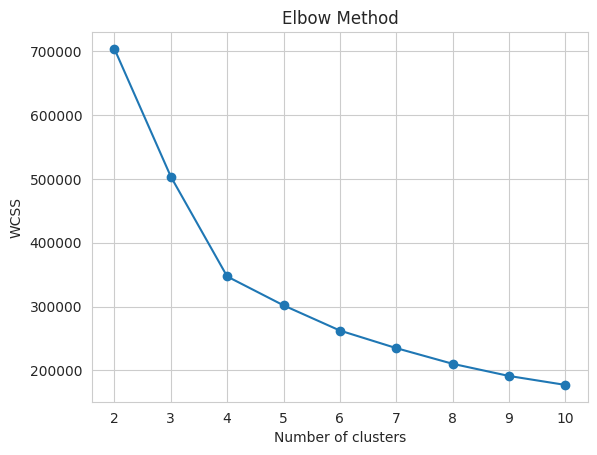

In [ ]:
# intuitively selecting 3 dimensions for k-means
X_kmeans = scaler.fit_transform(X_num[['add_to_cart_order', 'order_number', 'days_since_prior_order']])

wcss = []

for i in range(2,11):
    kmeans = KMeans(n_clusters=i, init = 'k-means++', random_state=42)
    kmeans.fit(X_kmeans)
    wcss.append(kmeans.inertia_)

plt.plot(range(2,11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

From the graph, the rate of decline begins to slow down after four clusters. There is a very distinct angle change at the position of four. Therefore, we consider four clusters to be an appropriate number of clusters.

#### 5.3 Silhoutte Score

In [ ]:
range_n_clusters = list(range(2, 11))
average_silhouette_scores = []

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, init = 'k-means++', random_state=42)
    cluster_labels = kmeans.fit_predict(X_kmeans)

    silhouette_avg = silhouette_score(X_processed, cluster_labels, sample_size=20000)
    average_silhouette_scores.append(silhouette_avg)

    print(f"For n_clusters = {n_clusters}, the average silhouette_score is : {silhouette_avg}")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 2, the average silhouette_score is : 0.005886312330810433


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 3, the average silhouette_score is : 0.03767929795979152


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 4, the average silhouette_score is : 0.05001255612645056


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 5, the average silhouette_score is : 0.051913384750523914


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 6, the average silhouette_score is : 0.044633046067202045


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 7, the average silhouette_score is : 0.026901177274123275


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 8, the average silhouette_score is : 0.01803868313406081


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 9, the average silhouette_score is : 0.021153579593250198


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


For n_clusters = 10, the average silhouette_score is : 0.022504349950291453


With respect to the silhouette scores, clusters with k value of 4 are observed to have the highest score in the given range. Keeping both these methods in mind, it is most suitable to go with 4 as the optimal value of k.

#### 5.4 Data Clusters

In [ ]:
# performing k-means clustering
n_clusters = 4

# Generate cluster centers and labels
df_kmeans = pd.DataFrame()
df_kmeans[['add_to_cart_order', 'order_number', 'days_since_prior_order']] = X_kmeans
kmeans_result = KMeans(n_clusters,init='k-means++', random_state=42).fit(df_kmeans)
kmeans_result.cluster_centers_

df_kmeans['cluster_labels'] = kmeans_result.labels_
df_kmeans

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,add_to_cart_order,order_number,days_since_prior_order,cluster_labels
0,0.366564,3.134079,-0.716569,2
1,0.645958,0.163128,1.079615,0
2,-0.611316,-0.808144,-1.053354,1
3,-0.890710,0.391663,-0.492046,1
4,-1.030407,-0.122540,0.518308,1
...,...,...,...,...
324340,-0.192225,-0.179674,-0.155261,1
324341,-1.030407,0.734465,-1.053354,1
324342,-0.192225,-0.865278,-0.604308,1
324343,-1.030407,-0.751010,-0.941092,1


In [ ]:
# plotting the clusters
fig = px.scatter_3d(df_kmeans, x='add_to_cart_order', y='order_number', z='days_since_prior_order', color='cluster_labels')
fig.update_traces(marker_size = 3)
fig.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


Through the above visualization, we can observe that clusters 2 and 3 seem to have the highest number of data points while cluster 0 is the smallest cluster in our dataset. Further, we can also see various unique cluster characteristics through this illustration.
Cluster 0 seems to have products with the lowest "add to cart order" values showing that these are the products that are mostly added in the cart first when the users begin their orders. These products also have a high value of "days since prior order", showing that they are not bought as frequently.
Cluster 1 on the other hand have products that are usually the first to be added to the cart and are also bought frequently in less intervals of time.
Cluster 2 again exhibits products that are usually bought frequently, while Cluster 3 contains products that are usually added to the cart in the middle of an order.

## 6. Dimensionality Reduction

Importing necessary libraries

In [28]:
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.preprocessing import FunctionTransformer

### 6.1 PCA

In [ ]:
df.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,924888,11,1,177411,72,Friday,1,4.0
1,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,268506,13,1,157915,20,Monday,9,20.0
2,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,2109664,4,0,145504,3,Tuesday,14,1.0
3,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,3209740,2,1,7981,24,Tuesday,13,6.0
4,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,1550174,1,1,66968,15,Wednesday,16,15.0


Method 1 - Using TruncatedSVD

In [ ]:
# Use TruncatedSVD for dimensionality reduction
svd = TruncatedSVD(n_components=2)

pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('svd', svd)])

# Apply the pipeline to fit and transform the data
svd_transformed = pipeline.fit_transform(df)

# Create a DataFrame with SVD Results
svd_df = pd.DataFrame(svd_transformed, columns=['Singular Value 1', 'Singular Value 2'])

print(svd_df.head())


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



   Singular Value 1  Singular Value 2
0         -2.511079          1.606574
1         -0.507754          0.670005
2          1.186012         -0.905912
3         -1.103165         -0.653899
4         -0.813924         -0.988010


TruncatedSVD is a dimensionality reduction technique used in machine learning to reduce the number of features in a dataset while retaining most of the important information. It is particularly useful for sparse datasets, such as those commonly found in text processing or user-item matrices in recommendation systems. The technique is based on Singular Value Decomposition (SVD), which is a mathematical method used to decompose a matrix into three other matrices.



Method 2 - Using PCA

In [29]:
# Define the PCA
pca = PCA(n_components=2)

# Apply the pipeline to fit and transform the data
pca_transformed = pca.fit_transform(X_fit)

# Create a DataFrame with PCA Results
pca_df = pd.DataFrame(pca_transformed, columns=['Principal Component 1', 'Principal Component 2'])

print(pca_df.head())

   Principal Component 1  Principal Component 2
0              -2.996492               2.055217
1              -0.028489               0.212387
2               0.602805               0.087587
3              -1.154043              -0.625977
4              -0.342933              -1.487147


1. Applicability to Sparse Data

* PCA typically requires the data to be centered by subtracting the mean of each feature. This operation turns sparse matrices (where most elements are zero) into dense matrices (where most elements are non-zero), which can significantly increase memory usage and computational cost. Therefore, PCA is not typically used on sparse datasets.

* TruncatedSVD, on the other hand, does not require centering and can be applied directly to sparse matrices without increasing their density. This makes TruncatedSVD particularly useful for dimensionality reduction in text data or other types of data that are naturally sparse.

2. Interpretation of Components
* PCA components represent directions in the original feature space that maximize the variance of the projected data. The components are orthogonal to each other and represent the directions in which the data varies the most.
* TruncatedSVD components are singular vectors associated with the largest singular values of the data matrix. While they also capture significant structures within the data, they do so without reference to the covariance structure that PCA emphasizes.

3. Use Cases
* PCA is widely used in applications where data density and computational resources are not limiting factors. It is well-suited for exploratory data analysis, noise reduction, and feature extraction in densely populated datasets.
* TruncatedSVD is particularly suited for text processing (e.g., latent semantic analysis), recommendation systems, and any application where the data is sparse and centering the data is not desirable or feasible.

#### 6.1.1 Elbow Method

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/pyt

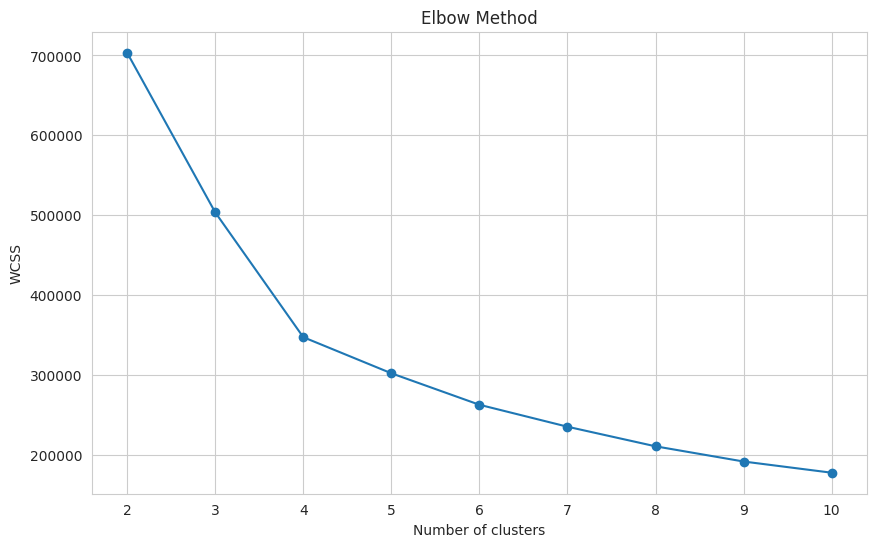

In [ ]:
wcss = []

for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(X_kmeans)
    wcss.append(kmeans.inertia_)

# Plotting the Elbow Method Graph
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')  # WCSS is Within-Cluster Sum of Squares
plt.show()

Ideal number of cluster = 4

### 6.2 Kmeans after PCA

In [ ]:
n_clusters = 4

# Initialize the KMeans model
kmeans = KMeans(n_clusters=n_clusters, random_state=42)

# Fit the model and predict cluster indices for each entry in pca_df
pca_df['Cluster'] = kmeans.fit_predict(pca_df[['Principal Component 1', 'Principal Component 2']])

print(pca_df.head())

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



   Principal Component 1  Principal Component 2  Cluster
0              -2.996492               2.055217        1
1              -0.028489               0.212387        3
2               0.602805               0.087587        0
3              -1.154043              -0.625977        3
4              -0.342933              -1.487147        3


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



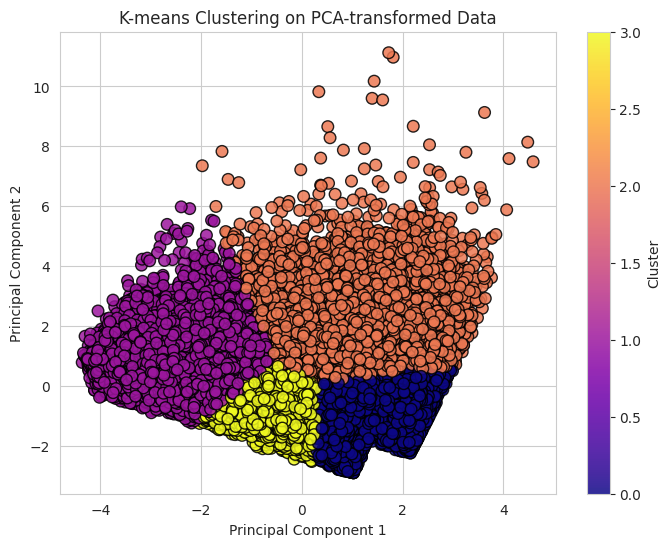

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(pca_df['Principal Component 1'], pca_df['Principal Component 2'], c=pca_df['Cluster'], cmap='plasma', marker='o', edgecolor='k', s=70, alpha=0.85)
plt.title('K-means Clustering on PCA-transformed Data')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster')
plt.show()

Inference:
* Cluster Separation: The separation of the clusters along the principal components suggests that PCA has transformed the features in such a way that the clusters are more distinguishable, which is helpful for K-means to assign the data points correctly.

* Outliers: There are a few points that are distant from the centers of their respective clusters. These could be considered outliers or noise in the dataset.

* Potential Cluster Characteristics: The clusters are aligned along the Principal Component 1 axis, suggesting that the variable(s) with the largest coefficients in the first principal component play a significant role in differentiating between the clusters.



### 6.3 T-SNE

In [13]:
X_fit_df = pd.DataFrame(X_fit)
X_fit_df.head()

,0,1,2,3,4
0,0.366564,0.834416,3.134079,-0.716569,-2.923658
1,0.645958,0.834416,0.163128,1.079615,-1.041763
2,-0.611316,-1.198443,-0.808144,-1.053354,0.134421
3,-0.890710,0.834416,0.391663,-0.492046,-0.100816
4,-1.030407,0.834416,-0.122540,0.518308,0.604895


In [14]:
X_num_sample = X_fit_df.sample(frac=0.1, random_state=42)
X_num_sample

,0,1,2,3,4
58330,-0.471619,0.834416,0.334529,-0.155261,1.075369
321382,0.226867,-1.198443,-0.465342,-0.828831,1.781079
175876,0.785655,0.834416,-0.522476,-0.379785,0.604895
170523,-0.611316,0.834416,1.591470,-0.379785,-1.041763
153851,-1.030407,0.834416,4.391019,-0.604308,-0.806526
...,...,...,...,...,...
6808,1.344443,0.834416,0.620198,-0.604308,-1.277000
41359,3.579596,0.834416,-0.579609,-0.379785,-0.336053
60398,0.366564,0.834416,-0.122540,-0.492046,-0.806526
204853,1.484140,-1.198443,0.163128,-0.492046,0.134421


Taking a sample of the data to tackle computational complexity with t-sne.

In [15]:
from sklearn.manifold import TSNE

# Apply t-SNE with 2 components
tsne = TSNE(n_components=2, random_state=42)
model_tsne = tsne.fit_transform(X_num_sample)

#### 6.3.1 Elbow Method

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

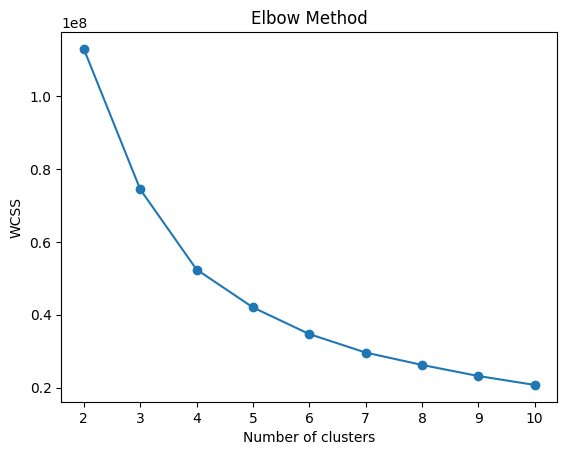

In [16]:
tsne_df = pd.DataFrame(model_tsne, columns=['t-sne Component 1', 't-sne Component 2'])

wcss = []

for i in range(2,11):
    kmeans = KMeans(n_clusters=i, init = 'k-means++', random_state=42)
    kmeans.fit(tsne_df)
    wcss.append(kmeans.inertia_)

plt.plot(range(2,11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

As seen in the graph above, 4 seems to be the optimal number of clusters.

### 6.4 Kmeans after T-SNE

In [17]:
#kmeans with reduced components through t-sne

kmeans_tsne = KMeans(n_clusters=4, init = 'k-means++', random_state=42)
kmeans_tsne.fit(tsne_df)
label = kmeans_tsne.predict(tsne_df)
tsne_df['label'] = label
tsne_df

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,t-sne Component 1,t-sne Component 2,label
0,-83.235573,-56.081394,0
1,56.151031,-26.155235,3
2,-29.196606,-45.437599,2
3,-81.344551,54.375824,0
4,-109.507545,30.262821,0
...,...,...,...
32429,-24.603857,2.862147,0
32430,-12.806185,-10.149270,2
32431,-21.527021,17.410803,0
32432,61.856388,45.110893,3


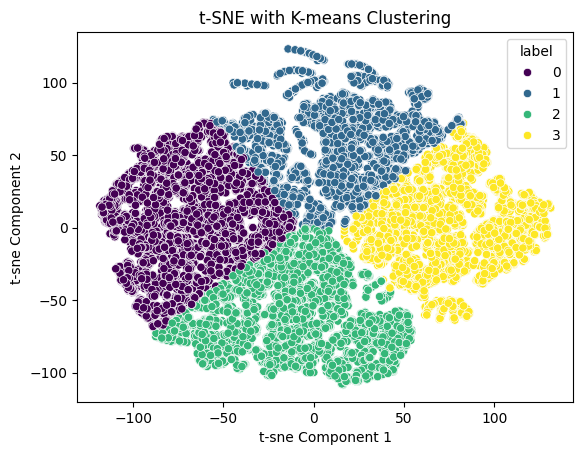

In [18]:
# Plot k-means clusters using seaborn

sns.scatterplot(data=tsne_df, x='t-sne Component 1', y='t-sne Component 2', hue='label', palette='viridis')
plt.title('t-SNE with K-means Clustering')
plt.show()

After performing t-sne and clustering the data based on two most significant dimensions, we can see that the data has interestingly been divided into 4 quadrants. Cluster 0 main consists of lower values of component 2 while cluster 1 mainly has high values of component 2. Further, cluster 2 exhibits high values of component 1, while cluster 3 majorly has low valus of component 1. It is also notable to see that there is no overlap between clusters, which means that the clustering has been performed very efficiently.

## 7. Hierarchial Clustering


### 7.1 Using T-SNE

In [19]:
from scipy.cluster.hierarchy import linkage, fcluster

Z = linkage(model_tsne, 'ward')
Z

array([[2.42400000e+03, 2.54430000e+04, 0.00000000e+00, 2.00000000e+00],
       [2.02300000e+03, 2.93700000e+03, 0.00000000e+00, 2.00000000e+00],
       [6.16900000e+03, 8.95400000e+03, 0.00000000e+00, 2.00000000e+00],
       ...,
       [6.48580000e+04, 6.48620000e+04, 6.98025601e+03, 1.45410000e+04],
       [6.48610000e+04, 6.48630000e+04, 8.26331453e+03, 1.78930000e+04],
       [6.48640000e+04, 6.48650000e+04, 1.26705290e+04, 3.24340000e+04]])

In [20]:
silhouette_scores = []

for k in range(2, 11):
  cluster_labels = fcluster(Z, k, criterion='maxclust')
  score = silhouette_score(model_tsne, cluster_labels, metric='euclidean')
  silhouette_scores.append(score)

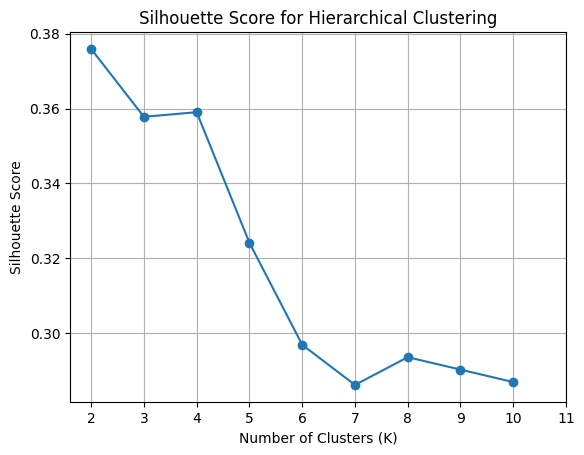

In [21]:
# Plot silhouette scores
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Silhouette Score for Hierarchical Clustering')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.xticks(range(2, 12))
plt.grid(True)
plt.show()

Looking at the silhouette scores, we will take the optimal k as 4 since it has a high score along with 2 and 3, however, being a higher number than 2 and 3, it will also give us a greater separation between the clusters.

In [22]:
num_clusters = 4
model_tsne = pd.DataFrame(model_tsne, columns = ['Component 1', 'Component 2'])
model_tsne['cluster_labels'] = fcluster(Z, num_clusters, criterion='maxclust')

Text(0.5, 1.0, 'Hierarchical Clustering with t-sne')

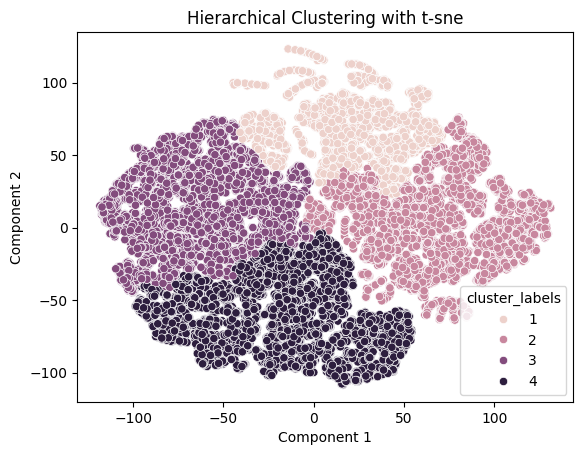

In [24]:
sns.scatterplot(x='Component 1', y='Component 2', hue='cluster_labels', data = model_tsne)
plt.title('Hierarchical Clustering with t-sne')

As seen in the illustration above, the 4 clusters made by hierarchical clustering using t-sne for dimensionality reduction are all well separated without any overlaps. The results are pretty similar to what was achieved via k-means clustering. However, since hierarcical clustering is computationally expensive, we conclude that k-means is the better route to go for performing clustering algorithms.

### 7.2 Using PCA

In [30]:
pca = PCA(n_components=2)
pca_transformed = pca.fit_transform(X_num_sample)

# Create a DataFrame with PCA Results
pca_df = pd.DataFrame(pca_transformed, columns=['Principal Component 1', 'Principal Component 2'])
pca_df

,Principal Component 1,Principal Component 2
0,-0.799880,-0.958702
1,0.813136,-0.161983
2,-0.068568,0.030759
3,-1.917873,0.354017
4,-3.886213,0.684613
...,...,...
32429,-0.912403,1.691085
32430,0.610978,2.434856
32431,-0.603266,0.561021
32432,0.745864,1.551103


In [31]:
Z = linkage(pca_df, 'ward')
Z

array([[5.00000000e+00, 7.50800000e+03, 0.00000000e+00, 2.00000000e+00],
       [4.72000000e+03, 2.91070000e+04, 0.00000000e+00, 2.00000000e+00],
       [2.59540000e+04, 3.01780000e+04, 0.00000000e+00, 2.00000000e+00],
       ...,
       [6.48600000e+04, 6.48630000e+04, 1.27242952e+02, 1.77820000e+04],
       [6.48610000e+04, 6.48620000e+04, 1.51620856e+02, 1.46520000e+04],
       [6.48640000e+04, 6.48650000e+04, 2.35837877e+02, 3.24340000e+04]])

In [37]:
silhouette_scores=[]

for k in range(2, 11):
  cluster_labels = fcluster(Z, k, criterion='maxclust')
  score = silhouette_score(pca_df, cluster_labels, metric='euclidean')
  silhouette_scores.append(score)

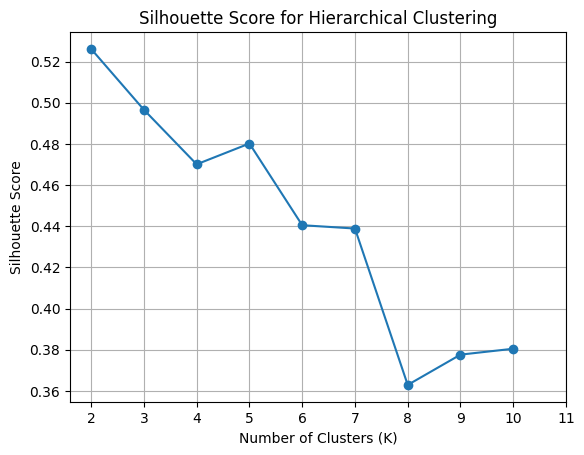

In [38]:
# Plot silhouette scores
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Silhouette Score for Hierarchical Clustering')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.xticks(range(2, 12))
plt.grid(True)
plt.show()

Cluster values of 2,3, 4 and 5 again seem to have the highest scores, however we shall go forward with 4 since it has a high score still and to maintain uniformity.

Text(0.5, 1.0, 'Hierarchical Clustering with PCA')

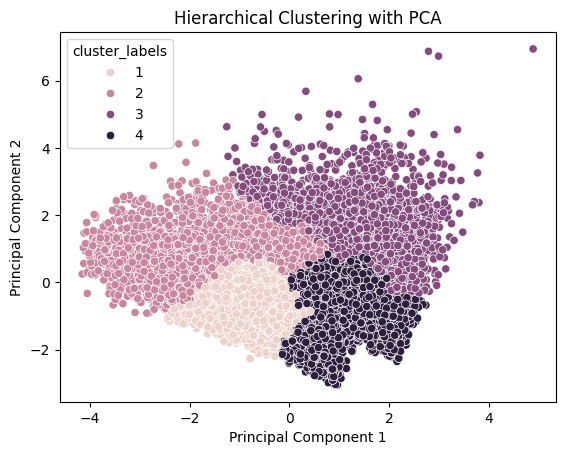

In [39]:
num_clusters = 4
pca_df['cluster_labels'] = fcluster(Z, num_clusters, criterion='maxclust')

sns.scatterplot(x='Principal Component 1', y='Principal Component 2', hue='cluster_labels', data = pca_df)
plt.title('Hierarchical Clustering with PCA')

As seen in the illustration above, the 4 clusters made in the technique are all well separated without any overlaps. The results are pretty similar to what was achieved via k-means clustering. However, since hierarcical clustering is computationally expensive, we conclude that k-means is the better route to go for performing clustering algorithms.